<a href="https://colab.research.google.com/github/modaresimr/UnifiedAR/blob/master/ADL_Seperate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

In [0]:
import numpy as np
import pandas as pd
import os
!pip install wget
import wget
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns;

import tensorflow as tf
import json
!pip install intervaltree
from intervaltree import IntervalTree


!pip install tensorflow-plot

from textwrap import wrap
import re
import itertools
import tfplot
import matplotlib
from sklearn.metrics import confusion_matrix



import plotly.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.figure_factory as ff
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))
wget.download('https://raw.githubusercontent.com/alim1369/pretty-print-confusion-matrix/master/confusion_matrix_pretty_print.py')
from confusion_matrix_pretty_print import pretty_plot_confusion_matrix

  Stored in directory: /root/.cache/pip/wheels/40/15/30/7d8f7cea2902b4db79e3fea550d7d7b85ecb27ef992b618f3f
Successfully built wget
  Stored in directory: /root/.cache/pip/wheels/d9/48/d2/cfea4b0f7cf82b873d1f282b200be49350b56fbffb6e9babbd
  Stored in directory: /root/.cache/pip/wheels/e5/d9/4a/0c3162411bad4df21befe385cea5bb26458ebb1aa9b2e1c13e
Successfully built tensorflow-plot biwrap


#Hyperparameters


In [0]:
def mySegmentation(w_history,buffer):
  return FixedTimeWindow(w_history,buffer, shift=pd.Timedelta(60, unit='s'), size=pd.Timedelta(300, unit='s') )

# Prepare dataset

## Download

In [0]:
def load():
  !mkdir dataset
  actfile="dataset/activities.csv"
  sensfile="dataset/sensor_events.csv"
  descfile="dataset/sensor_description.csv"
  # if not os.path.isfile(actfile) and os.path.isfile(sensfile):
  !rm $actfile $sensfile $descfile


  print('Beginning downloading files')

  activity_url = 'https://drive.google.com/uc?authuser=0&id=1cd_AQbHpK4LBHRyuAWQRP2nG4ilsfNMr&export=download'  
  wget.download(activity_url, actfile)  

  sensor_events_url = 'https://drive.google.com/uc?authuser=0&id=1n_ARZ90Ebo0VgS40RU-ycd_4tUhDdZs9&export=download'  
  wget.download(sensor_events_url, sensfile)  

  sensor_description_url = 'https://drive.google.com/uc?authuser=0&id=1QL7bdl8lRbyWdE5uSlMIS9LottgSvDja&export=download'  
  wget.download(sensor_description_url, descfile)  


  global sensor_events
  sensor_events = pd.read_csv(sensfile,)
  t=pd.to_datetime(sensor_events['time'],format='%Y-%m-%d %H:%M:%S')
  sensor_events.loc[:,'time']=t
  sensor_events = sensor_events.sort_values(['time'])
  sensor_events = sensor_events.reset_index()
  sensor_events = sensor_events.drop(columns=['index'])

  global activity_events
  activity_events = pd.read_csv(actfile,index_col='Id')
  
  activity_events = activity_events.sort_values(['StartTime','EndTime'])
  st=pd.to_datetime(activity_events['StartTime'],format='%Y-%m-%d %H:%M:%S')
  et=pd.to_datetime(activity_events['EndTime'],format='%Y-%m-%d %H:%M:%S')
  activity_events['StartTime']=st
  activity_events['EndTime']=et
  #activity_events['Interval']=pd.IntervalIndex.from_arrays(activity_events['StartTime'],activity_events['EndTime'],closed='both')
  activity_events['Duration']=et-st

  global sensor_desc
  global activities
  global activities_map_inverse
  global activities_map
  global sensor_desc_map
  global sensor_desc_map_inverse
  global sensor_id_map
  global sensor_id_map_inverse
  
  sensor_desc_map_inverse={}
  sensor_desc_map={}
  

  sensor_desc = pd.read_csv(descfile,index_col='ItemId')
  sensor_desc.ItemRange=sensor_desc.ItemRange.apply(lambda x: json.loads(x))
  for i,sd in sensor_desc[sensor_desc.Nominal==1].iterrows():
    sensor_desc_map_inverse[i]={k: v for v, k in enumerate(sd.ItemRange['range'])} 
    sensor_desc_map[i]={v: k for v, k in enumerate(sd.ItemRange['range'])} 
    
  
  sensor_events.value=sensor_events.apply(lambda x:x.value if not(x.SID in sensor_desc_map_inverse) else sensor_desc_map_inverse[x.SID][str(int(x.value))] if type(x.value) is float else sensor_desc_map_inverse[x.SID][x.value],axis=1)
  sensor_id_map={v: k for v, k in enumerate(sensor_desc.index)} 
  sensor_id_map_inverse={k: v for v, k in enumerate(sensor_desc.index)} 
    
  activities=activity_events['Activity'].unique()
  activities=np.insert(activities,0,'None')
  activities_map_inverse={k: v for v, k in enumerate(activities)}
  activities_map={v: k for v, k in enumerate(activities)}
  activity_events.Activity=activity_events.Activity.apply(lambda x:activities_map_inverse[x])
  global activity_events_tree
  activity_events_tree=IntervalTree()
  for i,act in activity_events.iterrows():
    activity_events_tree[act.StartTime.value:act.EndTime.value]=act  

load()


rm: cannot remove 'dataset/activities.csv': No such file or directory
rm: cannot remove 'dataset/sensor_events.csv': No such file or directory
rm: cannot remove 'dataset/sensor_description.csv': No such file or directory
Beginning downloading files


/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2828: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



### View File contents

In [0]:
sensor_events.iloc[20:25]

,SID,time,value
20,132,2017-01-30 07:58:40,0
21,127,2017-01-30 07:58:40,0
22,113,2017-01-30 07:58:40,0
23,286,2017-01-30 07:58:41,0.354432
24,96,2017-01-30 07:58:44,179071


In [0]:
activity_events.loc[1:1]

,StartTime,EndTime,Activity,Duration
Id,,,,
1,2017-01-30 07:58:30,2017-01-30 08:01:44,1,00:03:14


In [0]:
sensor_desc.loc[300:300]

,ItemName,Cumulative,Nominal,OnChange,ItemRange,Location,Object,SensorName
ItemId,,,,,,,,
300,kitchen_cupboard1,0,1,1,"{'range': ['CLOSED', 'OPEN']}",kitchen,cupboard1,state


## DataSet Description

In [0]:
#print("Activites: ",activities)
for a,v in activities_map.items():
    items=activity_events.loc[activity_events['Activity']==a]['Duration']
    print (a,v,'\t--> count=',items.count(), ' avg duration=',str(items.mean()))
 

0 None 	--> count= 0  avg duration= NaT
1 Entrance|Entering 	--> count= 21  avg duration= 0 days 00:01:38.380952
2 Staircase|Going_up 	--> count= 57  avg duration= 0 days 00:00:20.245614
3 Bathroom|Showering 	--> count= 19  avg duration= 0 days 00:17:14.105263
4 Bathroom|Using_the_sink 	--> count= 38  avg duration= 0 days 00:03:03.368421
5 Staircase|Going_down 	--> count= 57  avg duration= 0 days 00:00:16.824561
6 Living_room|Watching_TV 	--> count= 18  avg duration= 0 days 00:27:17.166666
7 Toilet|Using_the_toilet 	--> count= 8  avg duration= 0 days 00:02:03.125000
8 Office|Computing 	--> count= 46  avg duration= 0 days 02:33:13.021739
9 Kitchen|Preparing 	--> count= 19  avg duration= 0 days 00:01:30.105263
10 Kitchen|Cooking 	--> count= 19  avg duration= 0 days 00:10:51.789473
11 Living_room|Eating 	--> count= 19  avg duration= 0 days 00:11:30.210526
12 Kitchen|Washing_the_dishes 	--> count= 19  avg duration= 0 days 00:05:39.631578
13 Living_room|Cleaning 	--> count= 19  avg duration

# DataSet Visualization 

Living_room|Watching_TV
count                        18
mean     0 days 00:27:17.166666
std      0 days 00:04:33.795383
min             0 days 00:15:18
25%      0 days 00:24:52.750000
50%             0 days 00:27:50
75%      0 days 00:30:25.250000
max             0 days 00:34:06
Name: Duration, dtype: object


<Figure size 432x288 with 0 Axes>

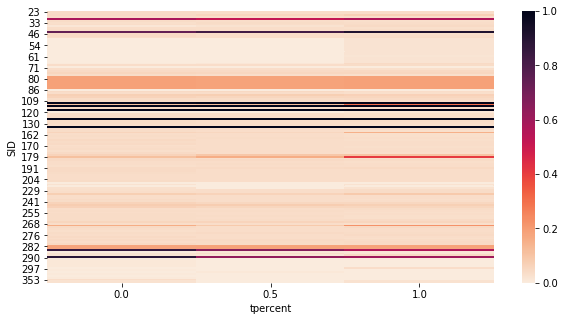

In [0]:
def view(i):

  tmp_act_evants=activity_events.loc[activity_events['Activity']==i]
  print(activities_map[i])
  print(tmp_act_evants['Duration'].describe())



  fig = plt.figure()

  tmp_act_evants['StartTime'].iloc[0]
  all=pd.DataFrame()
  for index, row in tmp_act_evants.iterrows():
    myse=sensor_events.loc[(sensor_events['time']>=row['StartTime']) & (sensor_events['time']<=row['EndTime'])].copy()
    myse['relative']=sensor_events['time']-row['StartTime']
    myse['tpercent']=myse['relative']/row['Duration']
    all=pd.concat([all,myse[['tpercent','SID']]])
    #plt.scatter(myse['tpercent'],myse['SID'])

  tmp=all.copy()

  tmp['tpercent']=(tmp['tpercent']*2).round(0)/2
  fig = plt.figure(figsize=(10,5))
  a=pd.pivot_table(tmp,columns='tpercent',index='SID',aggfunc=np.count_nonzero,fill_value=0)
  a=a/a.max();
  #plt.imshow(a, cmap='hot', interpolation='nearest')

  sns.heatmap(a/a.max(),cmap=sns.cm.rocket_r);
  global ali
  ali=tmp
view(6)

# Utils

In [0]:

def makeIntervalTree(acts):
  tree=IntervalTree()
  for act in acts:
    
    start=act['StartTime'].value;
    end=act['EndTime'].value;
    if(start==end):
      start=start-1
    tree[start:end]=act  
  return tree


def findOverlap(a,b):
  
  return ((min(a['EndTime'],b['EndTime'])-max(a['StartTime'],b['StartTime'])).value)/pd.to_timedelta('60s').value



In [0]:
class Buffer:
  def __init__(self, input, minsize,maxsize):
    self.data=input
    self.times=input.time.tolist()
    self.minsize =  minsize
    self.maxsize = maxsize
    self.start_index=0

  def removeTop(self, idx):
    self.start_index=idx
          
  
  def getEventsInRange(self,starttime,endtime):
    sindex=self.searchTime(starttime,-1)    
    eindex=self.searchTime(endtime,+1)    
    if(sindex is None):
      return None
    if(eindex is None):
      return None
    
  
    return self.data.iloc[sindex:eindex+1];
        
  def searchTime(self, time, operator=0):
    times=self.times;
    n=len(times);
    L = self.start_index
    R = n
    
    
    if operator ==1 :
      while L < R:
          m = int((L + R) / 2)

          if times[m] <= time:
              L = m + 1 
          else:
              R = m

      return L-1 if L>self.start_index else None
    else :
        while L < R:
          m = int((L + R) / 2)

          if times[m] < time:
              L = m + 1 
          else:
              R = m
        return L if L<n else None

# Feature Extraction

In [0]:

def featureExtraction(window):
  f=np.zeros(sum(1 for x in sensor_id_map))  
  for i in range(0,window.shape[0]):
    f[sensor_id_map_inverse[window.iat[i,0]]]=1
    
    #f[sensor_id_map_inverse[x.SID]]=1
  return f
  

#print('test:',featureExtraction(sensor_events.iloc[1:10]))

#%timeit featureExtraction(es)

In [0]:
def featureExtraction2(window):
  f=[]
  for i in range(0,window.shape[0]):
    f.append(sensor_id_map_inverse[window.iat[i,0]])
    
  
  return f
  


# Segmentation Abstract

In [0]:
 def segment(s_events,segment_method): 
    buffer=Buffer(s_events,0,0)  
    w_history=[]; 
    while(1):
      window=segment_method(w_history,buffer)
      if window is None:
        return
      w_history.append(window)  
      yield window

# Segmentation Methods


##Fixed Time Window

In [0]:
def FixedTimeWindow(w_history,buffer,shift,size):
    
    if len(w_history)==0 :
      lastStart=pd.to_datetime(0) 
    else :
      lastStart=w_history[len(w_history)-1]['start']
    
    lastStartshift=lastStart+shift;
    sindex=buffer.searchTime(lastStartshift,-1)
    
    if(sindex is None):
      return None
    #try:
      stime=buffer.times[sindex]

      eindex=buffer.searchTime(stime+size,+1)
      etime=buffer.times[eindex]
      
      window=buffer.data.iloc[sindex:eindex+1];
      buffer.removeTop(sindex)
      window.iat[0,1].value
      return {'window':window,'start':stime, 'end':etime}
    #except Exception as e:
    #  print('s:',sindex,'e:',eindex, 'l:',lastStart,'lss:',lastStartshift,'st:',stime,'et:',etime)
    #  print(e)
    


# Activity Fetcher

In [0]:
def activity(window):
  start=window.iat[0,1].value#.first.time
  end=window.iat[window.shape[0]-1,1].value
  acts=(activity_events_tree[start:end])

  if(len(acts)==0):
    return 0
  pacts=[]
  nacts=[]
  for x in acts:
    pacts.append((min(x.end,end)-max(x.begin,start))/(end-start))
    nacts.append(x.data)
  #np.argmax(pacts)
  return nacts[np.argmax(pacts)].Activity



#Train Test set maker

In [0]:
class Data:
  def __init__(self, name):
    self.name=name




SID                      400
time     2017-02-24 16:41:16
value                     40
Name: 746766, dtype: object

In [0]:
dataset_split=min(activity_events.StartTime)+((max(activity_events.EndTime)-min(activity_events.StartTime))/3*2)
Train=Data('train')
Test=Data('test')
Train.s_events=sensor_events[sensor_events.time<dataset_split]
Train.a_events=activity_events[activity_events.EndTime<dataset_split]

Test.s_events=sensor_events[sensor_events.time>=dataset_split]
Test.a_events=activity_events[activity_events.EndTime>=dataset_split]



all=[Train,Test]

for dtype in all:
  dtype.generator={}
  dtype.set={}
  dtype.label={}
  dtype.set_window={}

i=0
for a in activities_map:
  mean_duration=activity_events.loc[activity_events['Activity']==a]['Duration'].mean()
  if (mean_duration !=mean_duration):#NAT
    mean_duration=pd.Timedelta(3600, unit='s')
  seg_method=lambda w_history,buffer: FixedTimeWindow(w_history, buffer, shift=mean_duration/6, size=mean_duration/3 )
  for dtype in all:
    dtype.generator[a]=segment(dtype.s_events,seg_method)
    dtype.set[a]=[]
    dtype.label[a]=[]
    dtype.set_window[a]=[]
    for x in dtype.generator[a]:
        if i % 10000 ==0:
           print (i)
        i+=1
        
        act=activity(x['window'])
        dtype.set_window[a].append(x)
        dtype.set[a].append(featureExtraction(x['window']))
        dtype.label[a].append(act==a)
   
    dtype.set[a]=np.array(dtype.set[a])    
    dtype.label[a]=np.array(dtype.label[a])
    
    dtype.set[a] = np.reshape(dtype.set[a], (dtype.set[a].shape[0], 1, dtype.set[a].shape[1]))



0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000
210000
220000
230000
240000
250000
260000
270000
280000
290000
300000
310000
320000
330000
340000
350000
360000
370000
380000
390000
400000
410000
420000
430000
440000
450000
460000
470000
480000
490000
500000
510000
520000
530000
540000
550000
560000
570000
580000
590000
600000
610000
620000
630000
640000
650000
660000
670000
680000
690000
700000
710000
720000
730000
740000
750000
760000


#Model Builder

In [0]:
ftest=featureExtraction(sensor_events.iloc[0:1]);
model={}
for a in activities_map:
  print('Learning ',activities_map[a])
  from sklearn.utils import class_weight
  weights = class_weight.compute_class_weight('balanced',
                                            np.unique(Train.label[a]),
                                            Train.label[a])
  weights=np.append(weights,0)
  weights={0:weights[0],1:weights[1]}
  print('weights',weights)
  
  model[a] = tf.keras.models.Sequential([
    tf.keras.layers.Dense(32,input_shape=(1,ftest.size)),
    tf.keras.layers.LSTM(512, activation=tf.nn.relu),
    tf.keras.layers.Dense(512, activation=tf.nn.relu),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(2, activation=tf.nn.softmax)
  ])
  model[a].compile(optimizer='adam',loss='sparse_categorical_crossentropy',metrics=['accuracy'])
  

  
  
  model[a].fit(Train.set[a], Train.label[a], epochs=10,class_weight=weights)
  model[a].evaluate(Test.set[a], Test.label[a])
  pset=model[a].predict_classes(Test.set[a])
  cm=confusion_matrix(pset,Test.label[a])
  print(cm)
  from sklearn.metrics import f1_score
  print('F1_score=',f1_score(Test.label[a], pset, average='binary'))

Learning  None
weights {0: 1.0, 1: 0.0}
Epoch 1/10
690/690 [==============================] - 9s 13ms/sample - loss: 0.1100 - acc: 0.9580
Epoch 2/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.3510e-07 - acc: 1.0000
Epoch 3/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.4409e-07 - acc: 1.0000
Epoch 4/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.2837e-07 - acc: 1.0000
Epoch 5/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.3027e-07 - acc: 1.0000
Epoch 6/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.3320e-07 - acc: 1.0000
Epoch 7/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.2526e-07 - acc: 1.0000
Epoch 8/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.2612e-07 - acc: 1.0000
Epoch 9/10
690/690 [==============================] - 1s 1ms/sample - loss: 1.2577e-07 - acc: 1.0000
Epoch 10/10
364/364 [==============================] -

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
23060/23060 [==============================] - 34s 1ms/sample - loss: 0.1734 - acc: 0.9871
Epoch 2/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0405 - acc: 0.9912
Epoch 3/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0223 - acc: 0.9945
Epoch 4/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0281 - acc: 0.9921
Epoch 5/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0280 - acc: 0.9934
Epoch 6/10
23060/23060 [==============================] - 26s 1ms/sample - loss: 0.0120 - acc: 0.9970
Epoch 7/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0274 - acc: 0.9956
Epoch 8/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0315 - acc: 0.9945
Epoch 9/10
23060/23060 [==============================] - 27s 1ms/sample - loss: 0.0145 - acc: 0.9970
Epoch 10/10
12316/12316 [==============================] - 10s 790us/sample - loss

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
1338/1338 [==============================] - 10s 8ms/sample - loss: 0.6102 - acc: 0.9260
Epoch 2/10
1338/1338 [==============================] - 1s 1ms/sample - loss: 0.2766 - acc: 0.9111
Epoch 3/10
1338/1338 [==============================] - 2s 1ms/sample - loss: 0.1457 - acc: 0.9297
Epoch 4/10
1338/1338 [==============================] - 1s 1ms/sample - loss: 0.1352 - acc: 0.9380
Epoch 5/10
1338/1338 [==============================] - 1s 1ms/sample - loss: 0.1470 - acc: 0.9305
Epoch 6/10
1338/1338 [==============================] - 1s 1ms/sample - loss: 0.1151 - acc: 0.9477
Epoch 7/10
1338/1338 [==============================] - 1s 1ms/sample - loss: 0.1037 - acc: 0.9499
Epoch 8/10
1338/1338 [==============================] - 2s 1ms/sample - loss: 0.2114 - acc: 0.8886
Epoch 9/10
1338/1338 [==============================] - 2s 1ms/sample - loss: 0.1072 - acc: 0.9484
Epoch 10/10
709/709 [==============================] - 9s 13ms/sample - loss: 0.1632 - acc: 0.9252
[[627   0

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
2191/2191 [==============================] - 12s 6ms/sample - loss: 0.6847 - acc: 0.8909
Epoch 2/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.5028 - acc: 0.8827
Epoch 3/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.5240 - acc: 0.8115
Epoch 4/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4766 - acc: 0.8759
Epoch 5/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4568 - acc: 0.8686
Epoch 6/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4382 - acc: 0.8065
Epoch 7/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4378 - acc: 0.9197
Epoch 8/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4439 - acc: 0.7718
Epoch 9/10
2191/2191 [==============================] - 3s 1ms/sample - loss: 0.4819 - acc: 0.8708
Epoch 10/10
1158/1158 [==============================] - 10s 9ms/sample - loss: 0.3126 - acc: 0.9447
[[1086 

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
16574/16574 [==============================] - 32s 2ms/sample - loss: 0.3438 - acc: 0.9976
Epoch 2/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 3/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 4/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 5/10
16574/16574 [==============================] - 19s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 6/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 7/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 8/10
16574/16574 [==============================] - 19s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 9/10
16574/16574 [==============================] - 20s 1ms/sample - loss: 0.3354 - acc: 0.9993
Epoch 10/10
8833/8833 [==============================] - 12s 1ms/sample - loss: 0.

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
19790/19790 [==============================] - 37s 2ms/sample - loss: 0.3138 - acc: 0.9979
Epoch 2/10
19790/19790 [==============================] - 24s 1ms/sample - loss: 0.2816 - acc: 0.9994
Epoch 3/10
19790/19790 [==============================] - 24s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 4/10
19790/19790 [==============================] - 25s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 5/10
19790/19790 [==============================] - 25s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 6/10
19790/19790 [==============================] - 25s 1ms/sample - loss: 0.2816 - acc: 0.9994
Epoch 7/10
19790/19790 [==============================] - 25s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 8/10
19790/19790 [==============================] - 24s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 9/10
19790/19790 [==============================] - 25s 1ms/sample - loss: 0.3070 - acc: 0.9994
Epoch 10/10
10462/10462 [==============================] - 14s 1ms/sample - loss: 

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



Epoch 1/10
15962/15962 [==============================] - 35s 2ms/sample - loss: 0.2938 - acc: 0.9986
Epoch 2/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.2430 - acc: 0.9993
Epoch 3/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.2064 - acc: 0.9993
Epoch 4/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1794 - acc: 0.9991
Epoch 5/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1663 - acc: 0.9985
Epoch 6/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1636 - acc: 0.9989
Epoch 7/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1450 - acc: 0.9991
Epoch 8/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1605 - acc: 0.9989
Epoch 9/10
15962/15962 [==============================] - 20s 1ms/sample - loss: 0.1596 - acc: 0.9995
Epoch 10/10
8475/8475 [==============================] - 14s 2ms/sample - loss: 0.

/home/ali/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 due to no predicted samples.



#Save Model

In [0]:

for a in activities_map:
  print('saving ',activities_map[a])
  
  tf.contrib.saved_model.save_keras_model(model[a], "./saved_models/"+str(a)+"")


saving  None

Consider using a TensorFlow optimizer from `tf.train`.
INFO:tensorflow:Signatures INCLUDED in export for Classify: None
INFO:tensorflow:Signatures INCLUDED in export for Regress: None
INFO:tensorflow:Signatures INCLUDED in export for Predict: ['serving_default']
INFO:tensorflow:Signatures INCLUDED in export for Train: None
INFO:tensorflow:Signatures INCLUDED in export for Eval: None
INFO:tensorflow:No assets to save.
INFO:tensorflow:No assets to write.
INFO:tensorflow:SavedModel written to: ./saved_models/0/1557215593/saved_model.pb
saving  Entrance|Entering

Consider using a TensorFlow optimizer from `tf.train`.
INFO:tensorflow:Signatures INCLUDED in export for Classify: None
INFO:tensorflow:Signatures INCLUDED in export for Regress: None
INFO:tensorflow:Signatures INCLUDED in export for Predict: ['serving_default']
INFO:tensorflow:Signatures INCLUDED in export for Train: None
INFO:tensorflow:Signatures INCLUDED in export for Eval: None
INFO:tensorflow:No assets to save.

#Load Model

In [0]:
model2={}
for a in activities_map:
  print('saving ',activities_map[a])
  model2[a] = tf.contrib.saved_model.load_keras_model("./saved_models/"+str(a)+"/")


# Model Visualization

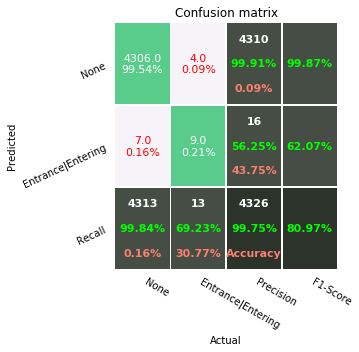

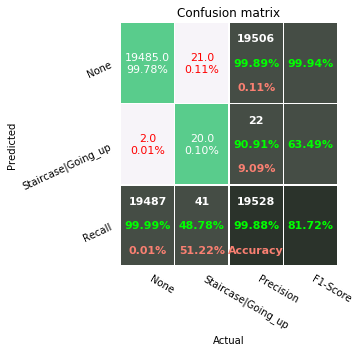

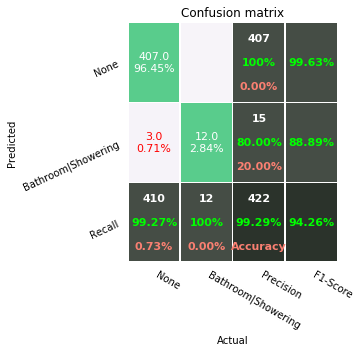

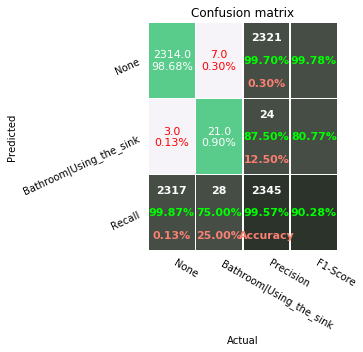

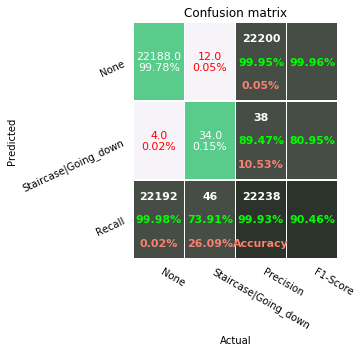

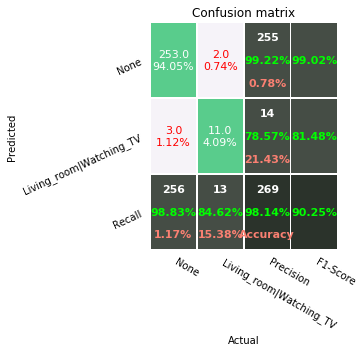

/content/confusion_matrix_pretty_print.py:145: RuntimeWarning:

invalid value encountered in long_scalars



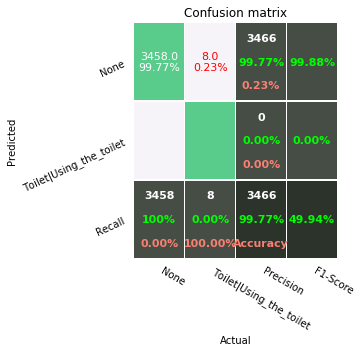

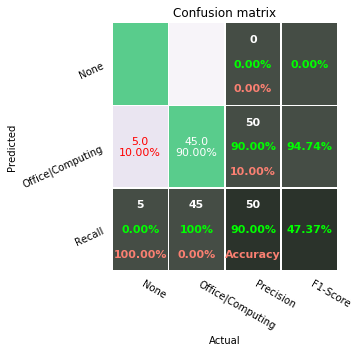

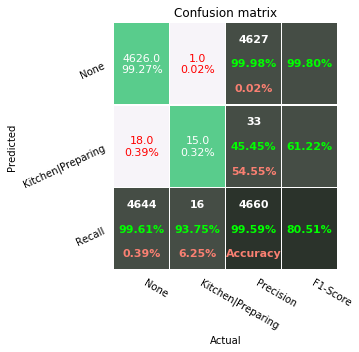

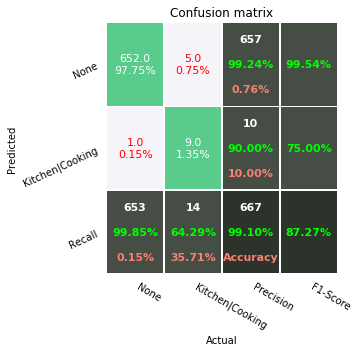

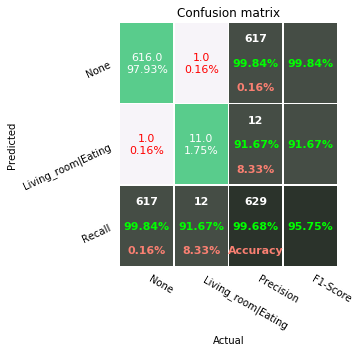

...

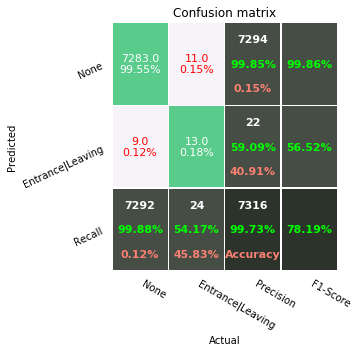

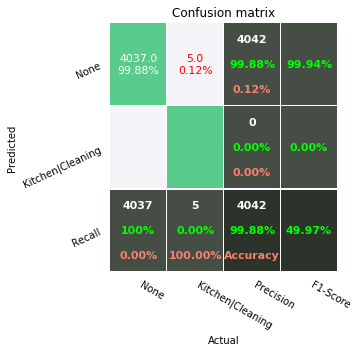

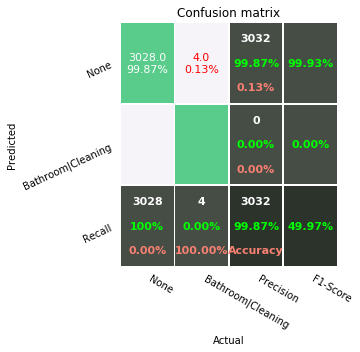

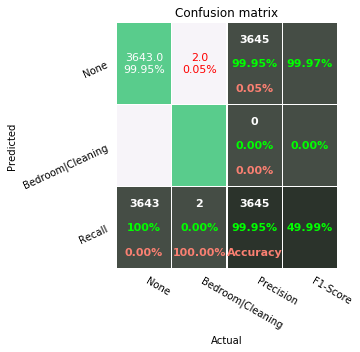

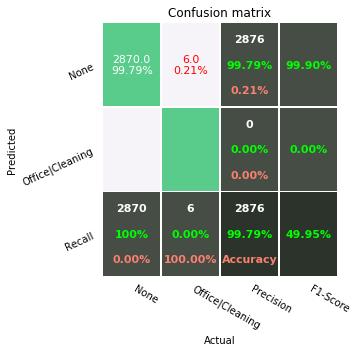

In [0]:
def plot_confusion_matrix(matrix,labels):
  import seaborn as sn
  import pandas as pd
  import matplotlib.pyplot as plt
    
  
  df_cm = pd.DataFrame(np.array(matrix).round(1), index = labels,
                  columns = labels)
  from confusion_matrix_pretty_print import pretty_plot_confusion_matrix
  
  #sn.heatmap(df_cm, annot=True)
  cmap = 'PuRd'
  
  pretty_plot_confusion_matrix(df_cm, cmap=cmap,figsize=[5,5])
  


for a in activities_map:
  label=['None',activities_map[a]]
  p_label=model[a].predict_classes(Test.set[a])
  cm=confusion_matrix(Test.label[a], p_label)
  if(cm.shape[0]==1):
    continue;
  
  plot_confusion_matrix(cm,label)


# Real Accuracy

In [0]:
def plotAct(acts):
  firstacts=acts.iloc[0];
  lastact=acts.iloc[-1];
  lastactinDay=acts.loc[acts['StartTime']<firstacts['StartTime']+pd.Timedelta('10h')].iloc[-1];
  for a in activities:
    acts=acts.append({'Activity':activities_map_inverse[a],'StartTime':firstacts['StartTime'],'EndTime':firstacts['StartTime']},ignore_index=True)
    
  acts=acts.sort_values(by='Activity')
  
  df2=acts.apply(lambda x:dict(Task=activities_map[x.Activity],Color=0, Start=x.StartTime, Finish=x.EndTime), axis=1).tolist()
  configure_plotly_browser_state()
  init_notebook_mode(connected=False)
  #fig=ff.create_gantt(df2, index_col='Color', group_tasks=True)
  fig=ff.create_gantt(df2, group_tasks=True)
  fig['layout'].update(margin=dict(l=150))
  fig['layout'].update(xaxis=dict(
        range=[firstacts['StartTime'], lastactinDay['EndTime']],
        rangeselector=dict(
            buttons=list([
                dict(count=4,
                     label='4h',
                     step='hour',
                     stepmode='backward'),
                dict(count=6,
                     label='6h',
                     step='hour',
                     stepmode='backward'),
                dict(count=8,
                     label='8h',
                     step='hour',
                     stepmode='backward'),
                dict(count=10,
                     label='10h',
                     step='hour',
                     stepmode='backward'),
                dict(count=12,
                     label='12h',
                     step='hour',
                     stepmode='backward'),
                dict(count=1,
                     label='1d',
                     step='day',
                     stepmode='backward'),
                dict(count=5,
                     label='5d',
                     step='day',
                     stepmode='backward'),
                
                dict(step='all')
            ])
        ),rangeslider=dict(
            visible = True,
            range=[firstacts['StartTime'], lastact['EndTime']],
        )))
  iplot( fig)
#plotAct(activity_events)


In [0]:
acts=testact
firstacts=acts.iloc[0];
lasttime=firstacts['StartTime']+pd.Timedelta('10h');
acts.loc[acts['StartTime']<lasttime].iloc[-1]

NameError: ignored

In [0]:
testact=[]
testactp=[]
testact=Test.a_events
#for i in range(0,len(Test.set_window[0])):
    #testact.append({'Activity':test_label[i],'StartTime':test_set_window[i]['start'],'EndTime':test_set_window[i]['end']})
    
  
for a in activities_map:
  pacts=model[a].predict_classes(Test.set[a])
  for i in range(0,len(Test.set_window[a])):
    if(pacts[i]!=0):
      testactp.append({'Activity':a,'StartTime':Test.set_window[a][i]['start'],'EndTime':Test.set_window[a][i]['end']})
  



In [0]:
#plotAct(testact[1:1000])
plotAct(pd.DataFrame(testact))
plotAct(pd.DataFrame(testactp))


/content/confusion_matrix_pretty_print.py:144: RuntimeWarning:

invalid value encountered in double_scalars

/content/confusion_matrix_pretty_print.py:145: RuntimeWarning:

invalid value encountered in double_scalars



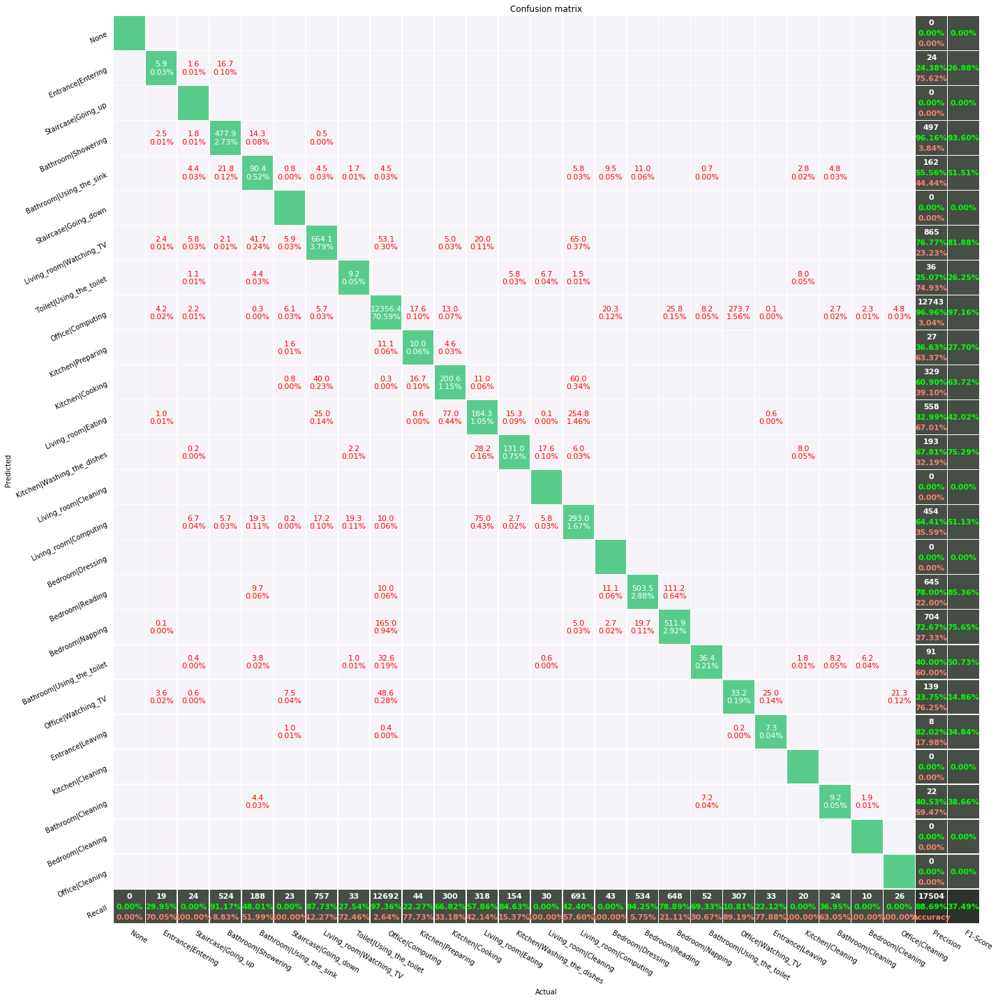

In [0]:

def myaccuracy(real,predicted):
  realtree=makeIntervalTree(real)
  predictedtree=makeIntervalTree(predicted)
  #predictedtree=makeIntervalTree(labels)
  
  
  timeconfusion_matrix=np.zeros((len(activities),len(activities)))
  
  for p in real:
    for q in predictedtree[p['StartTime'].value:p['EndTime'].value]:
      timeconfusion_matrix[p['Activity']][q.data['Activity']]+=findOverlap(p,q.data);
        
  #for p in predicted:
  #  for q in realtree[p['StartTime'].value:p['EndTime'].value]:
  #      timeconfusion_matrix[p['Activity']][q.data['Activity']]+=findOverlap(p,q.data);
        
  return timeconfusion_matrix

test_a_events_arr=[x for i,x in test_a_events.iterrows() ]
matrix=myaccuracy(test_a_events_arr,testactp)
#pd.DataFrame(matrix)
plot_confusion_matrix(matrix,activities)

# Analyzing Dataset

In [0]:
events_in_activities={}
sevents=Buffer(sensor_events,0,0)
for a in activities_map:
    events_in_activities[a]=[]
    for i,act in activity_events[activity_events.Activity==a].iterrows():
        sensors=sevents.getEventsInRange(act.StartTime,act.EndTime)
        events_in_activities[a].append(featureExtraction2(sensors))
    print(events_in_activities[a])

[]
[[175, 51, 49, 173, 171, 59, 169, 55, 163, 202, 165, 167, 48, 116, 116, 116, 116, 116, 51, 49, 59, 55, 48, 110, 46, 56, 15, 137, 110, 48, 55, 175, 169, 163, 165, 171, 173, 59, 167, 51, 49, 138, 84, 83, 138, 203, 137, 115, 134, 116, 110, 134, 115, 110, 4, 116, 115, 59, 51, 49, 48, 55, 16, 17, 116, 49, 48, 51, 59, 55, 116, 165, 163, 167, 169, 175, 171, 173, 96, 116, 102, 108, 51, 48, 77, 55, 49, 76, 59, 116, 9, 66, 88, 115, 110, 98, 115, 116, 110, 187, 187, 121, 119, 122, 231, 129, 123, 171, 173, 208, 175, 169, 116, 51, 110, 48, 167, 165, 55, 163, 59, 49, 115, 64, 115, 93, 214, 6, 199, 204, 106, 55, 51, 49, 64, 59, 48, 54, 102, 63, 0, 116, 211, 102, 37, 167, 173, 171, 169, 165, 175, 163, 48, 55, 122, 119, 121, 51, 123, 59, 49, 108, 64, 43, 93, 10, 68, 44, 62, 7, 58, 102, 59, 51, 55, 48, 49, 110, 16, 17, 116, 45, 74, 38, 13, 40, 163, 167, 169, 173, 175, 165, 171, 59, 49, 51, 55, 48, 116, 64, 129, 80, 79, 71, 53, 47, 12, 45, 102, 51, 59, 49, 48, 116, 55, 102, 81, 73, 171, 165, 175, 169,

In [0]:
matrix={}
count={}
n=len(sensor_desc);
for a in activities_map:
    matrix[a]=np.zeros((n+2,n+2))
    count[a]=np.zeros(n)
    for row in events_in_activities[a]:
        prev=n
        tmp={}
        for e in row:
            matrix[a][prev][e]+=1
            tmp[e]=1
            prev=e
        print(
        for i in tmp:
            count[a][i]+=1
            
        matrix[a][prev][n+1]+=1
    print(matrix[a])
    print(count[a])


[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0.

(-0.819015239248504,
 1.1076212711847366,
 -0.8350206970216554,
 0.8840859511372924)

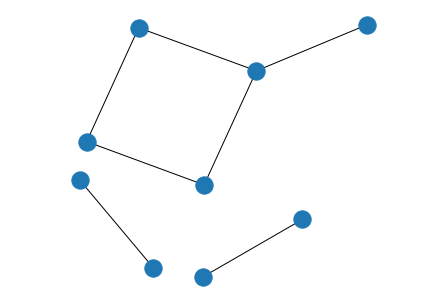

In [0]:
import matplotlib.pyplot as plt
import networkx as nx

g = nx.from_numpy_array(matrix[1]>20)

f = nx.Graph()                                                                                                                                     
#fedges = filter(lambda x: g.degree()[x[0]] >= 0 and g.degree()[x[1]] >= 0, g.edges())
f.add_edges_from(fedges)
isol=list(nx.isolates(g));
g.remove_nodes_from(isol)


nx.draw_kamada_kawai(g)
plt.axis('equal')

In [0]:
sum(matrix[1])

array([  7.,   9.,   5.,   6.,  33.,   4.,   5.,   9.,   8.,   6.,   8.,
         4.,   7.,   7.,   8.,   4.,  37.,  37.,   9.,   6.,  10.,   8.,
         7.,   9.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,  14.,   6.,   7.,  10.,   9.,  10.,   8.,
        13.,  11.,   3.,   7., 193., 188.,   8., 189.,   3.,   7.,   6.,
       187.,   4.,   5.,   8., 189.,   8.,  13.,   8.,   6.,  71.,   4.,
         6.,   4.,   8.,   4.,   6.,   8.,   6.,   8.,   6.,   4.,   4.,
         4.,   3.,   8.,   8.,   7.,   8.,  59.,  63.,   0.,   0.,   5.,
         9.,   7.,   6.,   4.,  11.,  15.,   8.,   9.,  17.,   3.,  10.,
         0.,   0.,  11.,  67.,   0.,   0.,   0.,   7.,   8., 106.,   0.,
       163.,   0.,   0.,   4.,   5., 126., 216.,   0.,   0.,  33.,   1.,
        33.,  33.,  33.,   0.,   5.,   0.,   0.,   0.,  24.,   0.,  16.,
        19.,   0.,  20.,   0.,   0.,  44.,  42.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   

In [0]:

sum(matrix[1].T)

array([  7.,   9.,   5.,   6.,  33.,   4.,   5.,   9.,   8.,   6.,   8.,
         4.,   7.,   7.,   8.,   4.,  37.,  37.,   9.,   6.,  10.,   8.,
         7.,   9.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,  14.,   6.,   7.,  10.,   9.,  10.,   8.,
        13.,  11.,   3.,   7., 193., 188.,   8., 189.,   3.,   7.,   6.,
       187.,   4.,   5.,   8., 189.,   8.,  13.,   8.,   6.,  71.,   4.,
         6.,   4.,   8.,   4.,   6.,   8.,   6.,   8.,   6.,   4.,   4.,
         4.,   3.,   8.,   8.,   7.,   8.,  59.,  63.,   0.,   0.,   5.,
         9.,   7.,   6.,   4.,  11.,  15.,   8.,   9.,  17.,   3.,  10.,
         0.,   0.,  11.,  67.,   0.,   0.,   0.,   7.,   8., 106.,   0.,
       163.,   0.,   0.,   4.,   5., 126., 216.,   0.,   0.,  33.,   1.,
        33.,  33.,  33.,   0.,   5.,   0.,   0.,   0.,  24.,   0.,  16.,
        19.,   0.,  20.,   0.,   0.,  44.,  42.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   

In [0]:
s1

In [0]:
a=pyopa.align_strings(pyopa.Sequence('ABC'),pyopa.Sequence('ABD'),pam250_env)
a=a[1]
a.convert_readable()

'A'